<a href="https://colab.research.google.com/github/malodept/covid19-proteins/blob/main/covid19_proteins.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install biopython


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 11.4 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore')
from Bio.SeqRecord import SeqRecord
from Bio import SeqIO
covid19 = SeqIO.read('/MN908947.fna', "fasta")
record = SeqIO.read('/MN908947.fna', "fasta")

In [ ]:
print(f'Le génome du virus responsable de la Covid-19 (connu sous le nom de SARS-CoV-2) se compose de {len(covid19)} bases génétiques ou lettres.')

Le génome du virus responsable de la Covid-19 (connu sous le nom de SARS-CoV-2) se compose de 29903 bases génétiques ou lettres.


In [ ]:
DNA= covid19.seq
print(DNA[:30])

ATTAAAGGTTTATACCTTCCCAGGTAACAA


In [ ]:
nucleotides={}
for n in DNA:
    if n in nucleotides:
        nucleotides[n] += 1
    else:
        nucleotides[n] =  1
print(nucleotides)

df= pd.DataFrame(data=nucleotides, index=[0]).T.reset_index()
df= df.rename(columns={0: 'frequency', 'index': 'nucleotides'})
df=df.sort_values(by=['frequency'], ascending=True)

{'A': 8954, 'T': 9594, 'G': 5863, 'C': 5492}


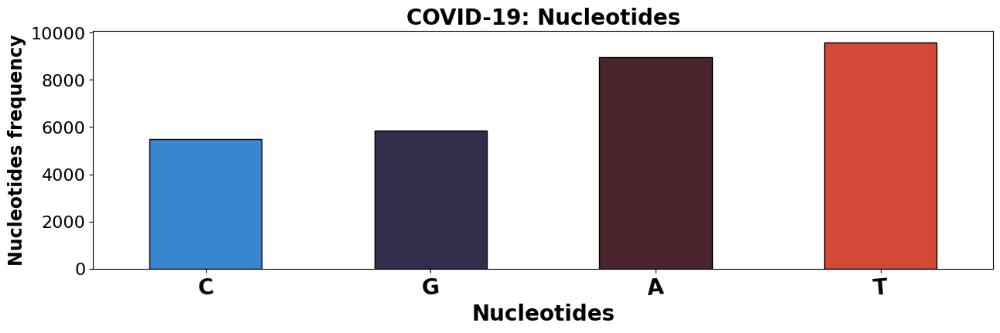

In [ ]:
plt.figure(figsize=(15,4))
a= df['frequency'].plot.bar(color=sns.color_palette('icefire',4), edgecolor='black')
plt.xticks(rotation=5)
plt.ylabel("Nucleotides frequency", weight='bold', fontsize=17)
r=list(range(len(df)))
plt.xticks(r, df.nucleotides, weight='bold', fontsize=20)
plt.xlabel("Nucleotides", weight='bold', size=20)
plt.yticks(fontsize=16)
plt.title("COVID-19: Nucleotides", weight='bold', size=20)
plt.savefig('covid_nucleotides.png')
plt.show()

On remarque qu'il y a plus de A et T que de G et C, ce qui est lié au fait que A s'apparie avec T et G avec C.

In [ ]:
df

,nucleotides,frequency
3,C,5492
2,G,5863
0,A,8954
1,T,9594


Déjà, l'ADN est transcrit en une molécule d'ARN

In [ ]:
mRNA=DNA.transcribe()
print(mRNA[:30])

AUUAAAGGUUUAUACCUUCCCAGGUAACAA


Maintenant, on passe à l'étape de traduction en acides aminés soit des séquences de 3 nucléotides A U G C, avec les condons stop notés *

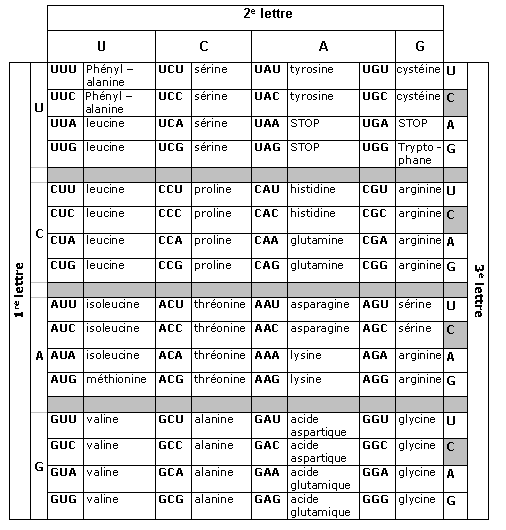



In [ ]:
amino_acids=mRNA.translate()
print(amino_acids)

IKGLYLPR*QTNQLSISCRSVL*TNFKICVAVTRLHA*CTHAV*LITNYCR*QDTSNSSIFCRLLTVSSVLQPIISTSRFRPGVTER*DGEPCPWFQRENTRPTQFACFTGSRRARTWLWRLRGGGLIRGTSTS*RWHLWLSRS*KRRFAST*TALCVHQTFGCSNCTSWSCYG*AGSRTRRHSVRS*W*DTWCPCPSCGRNTSGLPQGSSS*ER**RSWWP*LRRRSKVI*LRRRAWH*SL*RFSRKLEH*T*QWCYP*THA*A*RRGIHSLCR*QLLWP*WLPS*VH*RPSSTCW*SFMHFVRTTGLY*H*EGCILLP*T*A*NCLVHGTF*KEL*IADTF*N*IGKEI*HLQWGMSKFCISLKFHNQDYSTKG*KEKA*WLYG*NSICLSSCVTK*MQPNVPFNSHEV*SLW*NFMADGRFC*SHLRILWH*EFD*RRCHYLWLLTPKCCC*NLLSSMSQFRSRT*A*SCRIP**IWLENHSS*GWSHYCLWRLCVLLCWLP*QVCLLGSTC*R*HRL*PYRCCWRRFRRS**QPS*NTPKRESQHQYCW*L*T**RDRHYFGIFFCFHKCFCGNCERFGL*SIQTNC*ILW*F*SYKRKS*KRCLEYW*TEINTESSLCICIRGCSCCTINFLPHS*NCSKFCACFTEGRYNNTRWNFTVFTETH*CYDVHI*FGY*QSSCNGLHYRWCCSVDFAVAN*HLWHCL*KTQTRP*LA*REV*GRCRVS*RRLGNC*IYLNLCL*NCRWTNCHLCKGN*GECSDIL*ACK*IFGFVC*LYHYWWS*T*SLEFR*NICHALKGIVQKVC*IQRRNWPTHASKSPKRNYLLRGRNTSHRSVNRGSCLENW*FTTIRTTY**SC*SSIGWYTSLY*RAYVARNQRHRKVLCPCT*YDGNKQYLHTQRRCTNKGYFW**HCDRSARLQECEYHF*T**KD**ST**EVLCLYS*TRYRSK*VRLCCGRCCHKNFATSI*ITYTTGH*FR*VEYGYILLI**VW

In [ ]:
print(f"Le génome du Covid-19 contient {len(amino_acids)} acides aminés.")

Le génome du Covid-19 contient 9967 acides aminés.


In [ ]:
Proteins = amino_acids.split('*')
print(Proteins)

[Seq('IKGLYLPR'), Seq('QTNQLSISCRSVL'), Seq('TNFKICVAVTRLHA'), Seq('CTHAV'), Seq('LITNYCR'), Seq('QDTSNSSIFCRLLTVSSVLQPIISTSRFRPGVTER'), Seq('DGEPCPWFQRENTRPTQFACFTGSRRARTWLWRLRGGGLIRGTSTS'), Seq('RWHLWLSRS'), Seq('KRRFAST'), Seq('TALCVHQTFGCSNCTSWSCYG'), Seq('AGSRTRRHSVRS'), Seq('W'), Seq('DTWCPCPSCGRNTSGLPQGSSS'), Seq('ER'), Seq(''), Seq('RSWWP'), Seq('LRRRSKVI'), Seq('LRRRAWH'), Seq('SL'), Seq('RFSRKLEH'), Seq('T'), Seq('QWCYP'), Seq('THA'), Seq('A'), Seq('RRGIHSLCR'), Seq('QLLWP'), Seq('WLPS'), Seq('VH'), Seq('RPSSTCW'), Seq('SFMHFVRTTGLY'), Seq('H'), Seq('EGCILLP'), Seq('T'), Seq('A'), Seq('NCLVHGTF'), Seq('KEL'), Seq('IADTF'), Seq('N'), Seq('IGKEI'), Seq('HLQWGMSKFCISLKFHNQDYSTKG'), Seq('KEKA'), Seq('WLYG'), Seq('NSICLSSCVTK'), Seq('MQPNVPFNSHEV'), Seq('SLW'), Seq('NFMADGRFC'), Seq('SHLRILWH'), Seq('EFD'), Seq('RRCHYLWLLTPKCCC'), Seq('NLLSSMSQFRSRT'), Seq('A'), Seq('SCRIP'), Seq(''), Seq('IWLENHSS'), Seq('GWSHYCLWRLCVLLCWLP'), Seq('QVCLLGSTC'), Seq('R'), Seq('HRL'), Seq('PYRCCWRR

In [ ]:
print(f'Nous avons {len(Proteins)} chaînes d\'acides aminés dans le génome du Covid-19.')

Nous avons 775 chaînes d'acides aminés dans le génome du Covid-19.


Seules les chaînes de plus de 20 acides aminés codent des protéines fonctionnelles, les autres sont des oligopeptides. Nous ne conserverons que les protéines.

In [ ]:
for i in Proteins[:]:
    if len(i) < 20:
        Proteins.remove(i)

In [ ]:
print(f'Nous avons {len(Proteins)} protéines avec plus de 20 acides aminés dans le génome du Covid-19.')


Nous avons 80 protéines avec plus de 20 acides aminés dans le génome du Covid-19.


In [ ]:
df_prot=pd.DataFrame(Proteins)
df_prot['amino acid sequence'] = df_prot[0].apply(str)
df_prot['Protein length'] = df_prot[0].apply(len)
df_prot.rename(columns={0: "sequence"}, inplace=True)
pro=df_prot.drop('sequence', axis=1)
pro_= pro.sort_values(by=['Protein length'], ascending=False)

In [ ]:
pro_

,1,2,3,4,5,6,7,8,9,10,...,2693,2694,2695,2696,2697,2698,2699,2700,amino acid sequence,Protein length
0,D,T,S,N,S,S,I,F,C,R,...,None,None,None,None,None,None,None,None,Q,1
1,G,E,P,C,P,W,F,Q,R,E,...,None,None,None,None,None,None,None,None,D,1
58,Y,W,Q,N,S,R,L,T,F,F,...,None,None,None,None,None,None,None,None,C,1
57,D,C,S,I,H,F,C,T,V,S,...,None,None,None,None,None,None,None,None,N,1
56,R,Q,K,H,P,R,S,F,C,T,...,None,None,None,None,None,None,None,None,T,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25,I,I,C,K,I,S,V,C,L,L,...,None,None,None,None,None,None,None,None,R,1
24,V,H,L,L,C,I,I,L,L,C,...,None,None,None,None,None,None,None,None,N,1
23,F,L,C,T,W,I,G,C,N,H,...,None,None,None,None,None,None,None,None,V,1
22,G,F,N,C,F,W,L,S,C,R,...,None,None,None,None,None,None,None,None,M,1


In [ ]:
pd.options.display.max_colwidth = 80
import seaborn as sns
cm = sns.light_palette("green", as_cmap=True)

s = pro_.style.background_gradient(cmap=cm)

#cet affichage seaborn permet d'afficher les séquences en entier de façon claire


In [ ]:
s

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021,1

Maintenant que nous avons les séquences de protéines, nous allons chercher des informations à leur sujet sur Blast, en cherchant des séquences similaires.
Par exemple, si on cherche la séquence 62 : QADEYELMYSFVSEETGTLIVNSVLLFLAFVVFLLVTLAILTALRLCAYCCNIVNVSLVKPSFYVYSRVKNLNSSRVPDLLV ici https://blast.ncbi.nlm.nih.gov/Blast.cgi?PAGE_TYPE=BlastSearch&PROGRAM=blastp&BLAST_PROGRAMS=psiBlast, après quelques dizaines de secondes on trouve avec 100% de similarité : "envelope small membrane protein" du covid19, et la deuxième séquence trouvée la plus proche (95%), est "enevelope small membrane protein" pour le Sars Cov ce qui signifie que le Covid 19 et le Sars Cov ont une envelope small membrane très similaire.

Désormais, nous allons jouer sur les ORFs, c'est-à-dire les 6 différents cadres de lecture possibles en comptant le sens et l'antisens, et à chaque fois en commençant par le 1er nucléotide, puis le 2ème et enfin le 3ème.

In [ ]:
table=11
min_pro_len=200
def find_orfs_with_trans(seq, trans_table, min_protein_length):
    answer = []
    seq_len = len(seq)
    for strand, nuc in [(+1, seq), (-1, seq.reverse_complement())]:
        for frame in range(3):
            trans = str(nuc[frame:].translate(trans_table))
            trans_len = len(trans)
            aa_start = 0
            aa_end = 0
            while aa_start < trans_len:
                aa_end = trans.find("*", aa_start)
                if aa_end == -1: #brin antisens
                    aa_end = trans_len
                if aa_end - aa_start >= min_protein_length:
                    if strand == 1: #brin sens
                        start = frame + aa_start * 3
                        end = min(seq_len, frame + aa_end * 3 + 3)
                    else:
                        start = seq_len - frame - aa_end * 3 - 3
                        end = seq_len - frame - aa_start * 3
                    answer.append((start, end, strand, trans[aa_start:aa_end]))
                aa_start = aa_end + 1
    answer.sort()
    return answer

In [ ]:
orf_list = find_orfs_with_trans(record.seq, table, min_pro_len)
for start, end, strand, pro in orf_list:
    print(
        "%s...%s - length %i, strand %i, %i:%i"
        % (pro[:30], pro[-3:], len(pro), strand, start, end))

PKGKMESLVPGFNEKTHVQLSLPVLQVRDV...FAV - length 4409, strand 1, 253:13483
CTIVFKRVCGVSAARLTPCGTGTSTDVVYR...VNN - length 2701, strand 1, 13449:21555
LEKTTELLFLVMFLLTTKRTMFVFLVLLPL...HYT - length 1293, strand 1, 21502:25384
ASAQRSQITLHINELMDLFMRIFTIGTVTL...VPL - length 290, strand 1, 25347:26220
SSGLNELNIILVFLFGTLILAMADSNGTIT...LVQ - length 243, strand 1, 26459:27191
RSCCFRFHLNEQTKMSDNGPQNQRNAPRIT...TQA - length 433, strand 1, 28231:29533


Ici, nous avons recherché des séquences d'ADN susceptibles de coder sur des protéines fonctionnelles.

Remarque : on a toujours strand = 1, je ne vois pas d'interprétation particulière, c'est juste que les séquences ont toutes été trouvées sur le brin sens.

Maintenant, orf_list nous donne les séquences entières, que l'on peut copier-coller dans blast pour obtenir des informations sur ces séquences.

In [ ]:
orf_list

[(253,
  13483,
  1,
  'PKGKMESLVPGFNEKTHVQLSLPVLQVRDVLVRGFGDSVEEVLSEARQHLKDGTCGLVEVEKGVLPQLEQPYVFIKRSDARTAPHGHVMVELVAELEGIQYGRSGETLGVLVPHVGEIPVAYRKVLLRKNGNKGAGGHSYGADLKSFDLGDELGTDPYEDFQENWNTKHSSGVTRELMRELNGGAYTRYVDNNFCGPDGYPLECIKDLLARAGKASCTLSEQLDFIDTKRGVYCCREHEHEIAWYTERSEKSYELQTPFEIKLAKKFDTFNGECPNFVFPLNSIIKTIQPRVEKKKLDGFMGRIRSVYPVASPNECNQMCLSTLMKCDHCGETSWQTGDFVKATCEFCGTENLTKEGATTCGYLPQNAVVKIYCPACHNSEVGPEHSLAEYHNESGLKTILRKGGRTIAFGGCVFSYVGCHNKCAYWVPRASANIGCNHTGVVGEGSEGLNDNLLEILQKEKVNINIVGDFKLNEEIAIILASFSASTSAFVETVKGLDYKAFKQIVESCGNFKVTKGKAKKGAWNIGEQKSILSPLYAFASEAARVVRSIFSRTLETAQNSVRVLQKAAITILDGISQYSLRLIDAMMFTSDLATNNLVVMAYITGGVVQLTSQWLTNIFGTVYEKLKPVLDWLEEKFKEGVEFLRDGWEIVKFISTCACEIVGGQIVTCAKEIKESVQTFFKLVNKFLALCADSIIIGGAKLKALNLGETFVTHSKGLYRKCVKSREETGLLMPLKAPKEIIFLEGETLPTEVLTEEVVLKTGDLQPLEQPTSEAVEAPLVGTPVCINGLMLLEIKDTEKYCALAPNMMVTNNTFTLKGGAPTKVTFGDDTVIEVQGYKSVNITFELDERIDKVLNEKCSAYTVELGTEVNEFACVVADAVIKTLQPVSELLTPLGIDLDEWSMATYYLFDESGEFKLASHMYCSFYPPDEDEEEGDCEEEEFEPSTQYEYGTEDDYQGKPLEFGATSAALQPE

On trouve finalement 6 protéines : Replicase polyprotein 1a, Replicase polyprotein 1ab, Spike glycoprotein, Protein 3, Membrane protein, Nucleoprotein N.

Des recherches notamment ici https://pubmed.ncbi.nlm.nih.gov/24606680/ expliquent que l'élaboration d'un vaccin doit cibler une expression de Spike, qui est la protéine permettant au virus de pénétrer dans les cellules humaines. Sur le coronavirus, les spike proteins sont les pics formant une "couronne".

In [ ]:
spike='LEKTTELLFLVMFLLTTKRTMFVFLVLLPLVSSQCVNLTTRTQLPPAYTNSFTRGVYYPDKVFRSSVLHSTQDLFLPFFSNVTWFHAIHVSGTNGTKRFDNPVLPFNDGVYFASTEKSNIIRGWIFGTTLDSKTQSLLIVNNATNVVIKVCEFQFCNDPFLGVYYHKNNKSWMESEFRVYSSANNCTFEYVSQPFLMDLEGKQGNFKNLREFVFKNIDGYFKIYSKHTPINLVRDLPQGFSALEPLVDLPIGINITRFQTLLALHRSYLTPGDSSSGWTAGAAAYYVGYLQPRTFLLKYNENGTITDAVDCALDPLSETKCTLKSFTVEKGIYQTSNFRVQPTESIVRFPNITNLCPFGEVFNATRFASVYAWNRKRISNCVADYSVLYNSASFSTFKCYGVSPTKLNDLCFTNVYADSFVIRGDEVRQIAPGQTGKIADYNYKLPDDFTGCVIAWNSNNLDSKVGGNYNYLYRLFRKSNLKPFERDISTEIYQAGSTPCNGVEGFNCYFPLQSYGFQPTNGVGYQPYRVVVLSFELLHAPATVCGPKKSTNLVKNKCVNFNFNGLTGTGVLTESNKKFLPFQQFGRDIADTTDAVRDPQTLEILDITPCSFGGVSVITPGTNTSNQVAVLYQDVNCTEVPVAIHADQLTPTWRVYSTGSNVFQTRAGCLIGAEHVNNSYECDIPIGAGICASYQTQTNSPRRARSVASQSIIAYTMSLGAENSVAYSNNSIAIPTNFTISVTTEILPVSMTKTSVDCTMYICGDSTECSNLLLQYGSFCTQLNRALTGIAVEQDKNTQEVFAQVKQIYKTPPIKDFGGFNFSQILPDPSKPSKRSFIEDLLFNKVTLADAGFIKQYGDCLGDIAARDLICAQKFNGLTVLPPLLTDEMIAQYTSALLAGTITSGWTFGAGAALQIPFAMQMAYRFNGIGVTQNVLYENQKLIANQFNSAIGKIQDSLSSTASALGKLQDVVNQNAQALNTLVKQLSSNFGAISSVLNDILSRLDKVEAEVQIDRLITGRLQSLQTYVTQQLIRAAEIRASANLAATKMSECVLGQSKRVDFCGKGYHLMSFPQSAPHGVVFLHVTYVPAQEKNFTTAPAICHDGKAHFPREGVFVSNGTHWFVTQRNFYEPQIITTDNTFVSGNCDVVIGIVNNTVYDPLQPELDSFKEELDKYFKNHTSPDVDLGDISGINASVVNIQKEIDRLNEVAKNLNESLIDLQELGKYEQYIKWPWYIWLGFIAGLIAIVMVTIMLCCMTSCCSCLKGCCSCGSCCKFDEDDSEPVLKGVKLHYT'

def char_frequency(str1):
    dict = {}
    for n in str1:
        keys = dict.keys()
        if n in keys:
            dict[n] += 1
        else:
            dict[n] = 1
    return dict
print(char_frequency(spike))
amino_acids=char_frequency(spike)

#Get amino acids dataset
aas= pd.DataFrame(data=amino_acids, index=[0]).T.reset_index()
aas= aas.rename(columns={0: 'frequency', 'index': 'amino_acids'})
aas=aas.sort_values(by=['frequency'], ascending=True)

{'L': 114, 'E': 50, 'K': 63, 'T': 102, 'F': 79, 'V': 98, 'M': 15, 'R': 43, 'P': 58, 'S': 99, 'Q': 62, 'C': 40, 'N': 88, 'A': 79, 'Y': 54, 'G': 82, 'D': 62, 'H': 17, 'W': 12, 'I': 76}


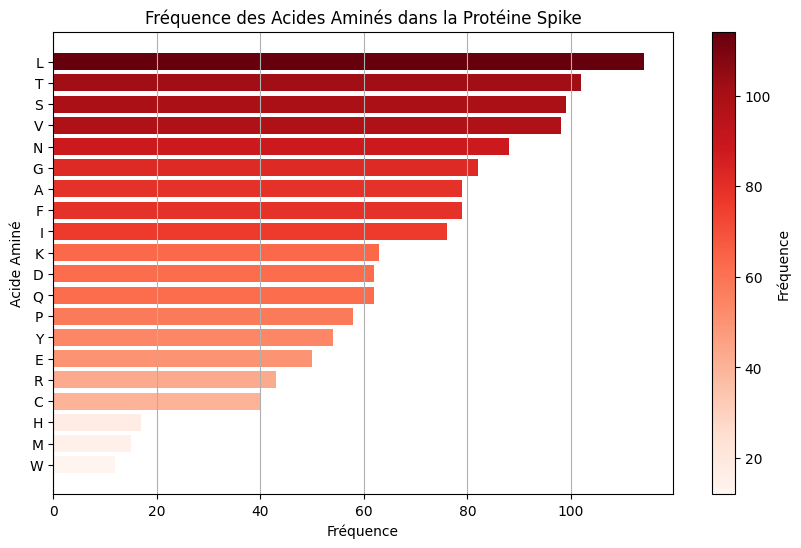

In [ ]:
import matplotlib.colors as mcolors

cmap = plt.cm.Reds
norm = mcolors.Normalize(vmin=aas['frequency'].min(), vmax=aas['frequency'].max())
colors = [cmap(norm(value)) for value in aas['frequency']]

plt.figure(figsize=(10, 6))
bars = plt.barh(aas['amino_acids'], aas['frequency'], color=colors)
plt.xlabel('Fréquence')
plt.ylabel('Acide Aminé')
plt.title('Fréquence des Acides Aminés dans la Protéine Spike')
plt.grid(axis='x')

sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm)
cbar.set_label('Fréquence')

plt.show()
